# Image Segmentation - part 1

Image segmentation is the process of splitting images into multiple layers.

Splitting the image into a collection of image objects with comparable properties is the first stage in image processing.

Here we'll be using the Scikit-Image module for image processing in Python and following the processes presented in this [article](https://www.geeksforgeeks.org/image-segmentation-using-pythons-scikit-image-module/).

Images used are from:

- Forest Aerial Images for Segmentation ([x](https://www.kaggle.com/datasets/quadeer15sh/augmented-forest-segmentation))

- Semantic Segmentation of Underwater Imagery (SUIM) ([x](https://www.kaggle.com/datasets/ashish2001/semantic-segmentation-of-underwater-imagery-suim))

# Converting to Grayscale

Converting a 3-channel RGB image to one channel greyscale image is the first step in many image processing implementations.

The function `rgb2gray()` gets the average of the red, green and blue for each pixel to get the greyscale value, creating an acceptable gray approximation of the original image.

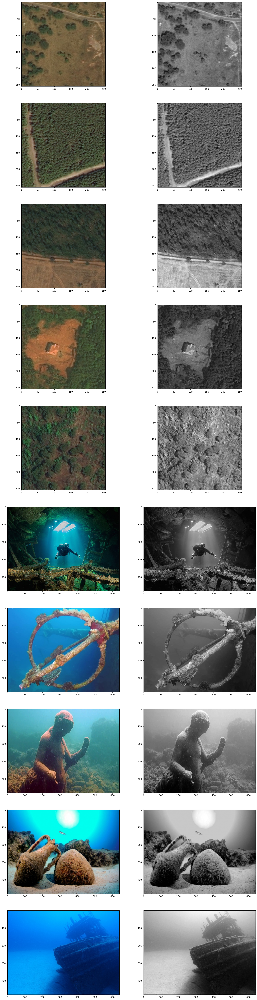

In [1]:
import os
import skimage
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,80))

# loading images from folder
list_files = os.listdir('images')
image_list = []
for filename in list_files:
    image_list.append(skimage.io.imread('images\\' + filename))

# displaying the images
for idx, image in enumerate(image_list):
    axes[idx,0].imshow(image)
    # converting RGB image to grey
    axes[idx,1].imshow(rgb2gray(image), cmap="gray")


# Converting to HSV

HSV (Hue, Saturation, Value) color model remaps the RGB channels into a dimension that is simpler for humans to understand.

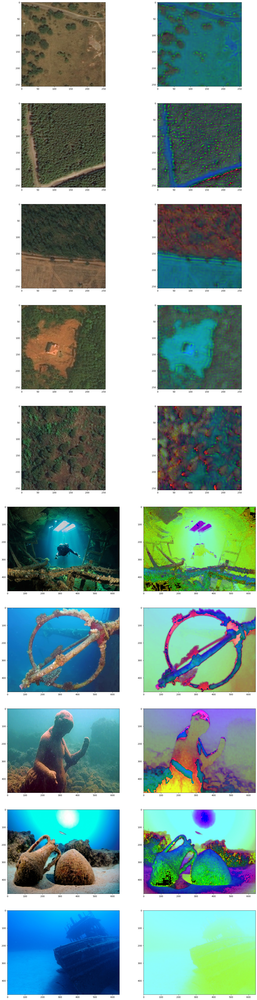

In [15]:
from skimage.color import rgb2hsv

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,80))

# displaying the images
for idx, image in enumerate(image_list):
    axes[idx,0].imshow(image)
    # converting RGB image to HSV
    axes[idx,1].imshow(rgb2hsv(image), cmap="gray")

# Supervised segmentation

This type of segmentation requeries external input.

### Segmentation by threshold - manual input

Testing differente thresholds to binarize the image and separate it from the background.

First step is selecting a threshold, if the value is greater than the threshold then the result is 1 (white) else is 0 (black).

The binarized result can be used for detecting edges, analyzing contrast or color differences.

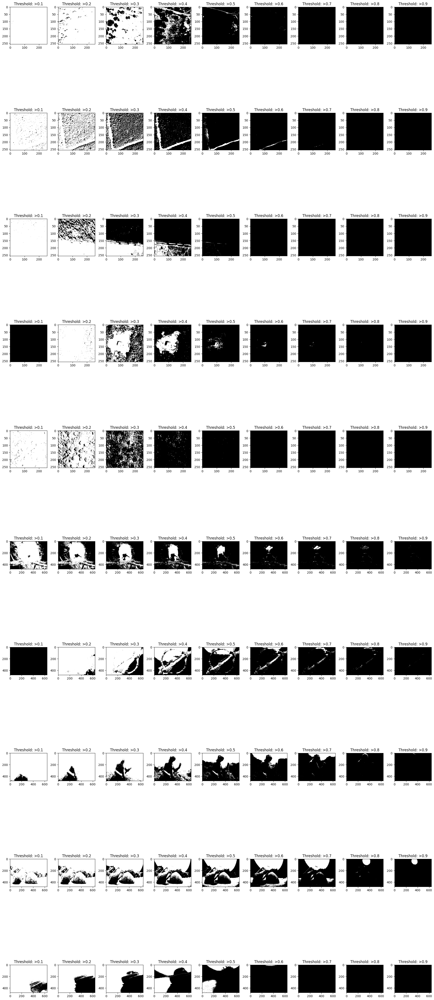

In [21]:
# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 9, figsize=(20,50))

# displaying the images
for idx, image in enumerate(image_list):
    # converting RGB image to gray
    gray = rgb2gray(image)
    for i in range(1,10):
        # Iterating different thresholds
        binarized_gray = (gray > i*0.1)*1
        axes[idx,i-1].title.set_text("Threshold: >" + str(round(i*0.1,1)))
        axes[idx,i-1].imshow(binarized_gray, cmap="gray")

plt.tight_layout()